In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import csv
import scanpy.api as sc
from igraph import *
from MulticoreTSNE import MulticoreTSNE as TSNE #faster TSNE alternative
from anndata import read_h5ad
import dill # for saving everything

sc.logging.print_versions()

/home/ubuntu/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


scanpy==1.2.2+145.g8360b3b anndata==0.6.8 numpy==1.14.3 scipy==1.1.0 pandas==0.23.0 scikit-learn==0.19.1 statsmodels==0.9.0 python-igraph==0.7.1 louvain==0.6.1 


# Load data

## 18, 21 and 24 months

In [ ]:
path = '/data/maca/data/'
maca10x182124metadata = pd.read_csv('/data/maca/data/MACA_10x_18-21-24_qc.csv',usecols = ['channel','tissue','tissue.notes','mouse.age','mouse.sex'])

maca10x182124metadata = maca10x182124metadata.rename(columns = {'mouse.age':'age','mouse.sex':'sex','tissue.notes':'subtissue'})
maca10x182124metadata.index = range(len(maca10x182124metadata))

In [ ]:
maca10x182124metadata.head()
#len(maca10x182124metadata)

In [ ]:
adata182124aux = []
for i in range(0,len(maca10x182124metadata)):
    path = '/data/maca/data/' + maca10x182124metadata.channel[i] + '/'
    foo = sc.read(path + 'matrix.mtx', cache=True).transpose()
    foo.var_names = np.genfromtxt(path + 'genes.tsv', dtype=str)[:, 1]
    foo.obs_names = np.genfromtxt(path + 'barcodes.tsv', dtype=str)
    foo.obs['tissue'] = str(maca10x182124metadata.tissue[i]).title()
    #foo.obs['subTissue'] = str(maca10x182124metadata.subtissue[i]).title()
    
    
    if pd.isnull(maca10x182124metadata.subtissue[i]):
        foo.obs['subtissue'] = maca10x182124metadata.subtissue[i]
    else:        
        foo.obs['subtissue'] = str(maca10x182124metadata.subtissue[i]).title()
        
    
    foo.obs['age'] = str(maca10x182124metadata.age[i]) + 'm'
    
    if maca10x182124metadata.sex[i] == 'M':
        foo.obs['sex'] = 'male'
    else:
        foo.obs['sex'] = 'female'
    
    if maca10x182124metadata.tissue[i] == 'MUSCLE':
        foo.obs['tissue'] = 'Limb_Muscle'
        
    sc.pp.filter_cells(foo, min_genes=250)
    
    foo.obs['channel'] = maca10x182124metadata.channel[i]# + foo.obs_names.split("-")[0]
    
    foo.obs['cell_ontology_class'] = 'NA' #maca10x3metadata.cell_ontology_class[i]
    #foo.obs['CellTypeID'] = maca10x3metadata.cell_ontology_id[i]
    #foo.obs['FreeAnn'] = maca10x3metadata.free_annotation[i]
    
    adata182124aux.append(foo)
    #print(adata3.X.size*8/1000000) # convert to Mb


first = adata182124aux.pop()
adata182124 = first.concatenate(adata182124aux)
adata182124.obs['cell'] = adata182124.obs['channel'] + '_' + adata182124.obs_names
adata182124.obs['cell'] = adata182124.obs['cell'].apply(lambda x: pd.Series(x.split('-')))[0]
adata182124.obs['method'] = 'droplet'

adata182124.obs.head()

In [ ]:
set(adata182124.obs['tissue'])


## 3months

In [ ]:
path = '/data/maca/data/10x/'
maca10x3metadata = pd.read_csv('/data/maca/data/10x/MACA_10x_3_qc.csv',usecols = ['channel','tissue','tissue.notes','mouse.age','mouse.sex','pool'])
maca10x3metadata2 = pd.read_csv('/data/maca/data/10x/TM_droplet_metadata.csv', low_memory=False)

maca10x3metadata = maca10x3metadata.rename(columns = {'mouse.age':'age','mouse.sex':'sex','tissue.notes':'subtissue'})
#maca10x3metadata = maca10x3metadata[maca10x3metadata.age == 3]
maca10x3metadata.index = range(len(maca10x3metadata))

maca10x3metadata.head()

In [ ]:
adata3aux = []
for i in range(0,len(maca10x3metadata)):
    #print(i)
    path = '/data/maca/data/10x/' + maca10x3metadata.channel[i] + '/'
    foo = sc.read(path + 'matrix.mtx', cache=True).transpose()
    foo.var_names = np.genfromtxt(path + 'genes.tsv', dtype=str)[:, 1]
    foo.obs_names = np.genfromtxt(path + 'barcodes.tsv', dtype=str)
    foo.obs['tissue'] = maca10x3metadata.tissue[i]
    foo.obs['subtissue'] = maca10x3metadata.subtissue[i]
    foo.obs['age'] = str(maca10x3metadata.age[i]) + 'm'
    
    if maca10x3metadata.sex[i] == 'M':
        foo.obs['sex'] = 'male'
    else:
        foo.obs['sex'] = 'female'
    
    if maca10x3metadata.tissue[i] == 'Muscle':
        foo.obs['tissue'] = 'Limb_Muscle'
        
    sc.pp.filter_cells(foo, min_genes=250)
    
    foo.obs['channel'] = maca10x3metadata.channel[i]# + foo.obs_names.split("-")[0]
    
    foo.obs['cell_ontology_class'] = 'NA' #maca10x3metadata.cell_ontology_class[i]
    #foo.obs['CellTypeID'] = maca10x3metadata.cell_ontology_id[i]
    #foo.obs['FreeAnn'] = maca10x3metadata.free_annotation[i]
    
    adata3aux.append(foo)
    #print(adata3.X.size*8/1000000) # convert to Mb

first = adata3aux.pop()
adata3 = first.concatenate(adata3aux)
adata3.obs['cell'] = adata3.obs['channel'] + '_' + adata3.obs_names
adata3.obs['cell'] = adata3.obs['cell'].apply(lambda x: pd.Series(x.split('-')))[0]
adata3.obs['method'] = 'droplet'
display(adata3.obs.head())
adata3

In [ ]:
set(adata3.obs['tissue'])

## concatenate all time points

In [ ]:
adata = adata182124.concatenate([adata3])
adata

## import tabula-muris facs data

In [ ]:
tm_facs_metadata = pd.read_csv('/data/maca/data/facs3mo/TM_facs_metadata.csv',usecols = ['cell','tissue','subtissue','mouse.sex','method','cell_ontology_class','cell_ontology_id','free_annotation'])
tm_facs_metadata = tm_facs_metadata.rename(columns = {'mouse.sex':'sex'})
display(tm_facs_metadata.head())
tm_facs_metadata = tm_facs_metadata.set_index('cell')
tm_facs_metadata.tail()

In [ ]:
tm_facs_data = read_h5ad('/data/maca/data/facs3mo/TM_facs_mat.h5ad')
tm_facs_data

In [ ]:
tm_facs_data.obs.tail()

In [ ]:
#tm_facs_data.obs['cell_ontology_class'] = tm_facs_data.obs['index'].map(tm_facs_metadata['cell_ontology_class'])
tm_facs_data.obs = tm_facs_metadata
tm_facs_data.obs['age'] = '3m'
for i in range(0,len(tm_facs_data.obs)):
    if tm_facs_data.obs['sex'][i] == 'M':
        tm_facs_data.obs['sex'][i] = 'male'
    else:
        tm_facs_data.obs['sex'][i] = 'female'
    if tm_facs_data.obs['tissue'][i] == 'Mammary_Gland':
        tm_facs_data.obs['tissue'][i] = 'Mammary'

tm_facs_data.obs.head()

In [ ]:
tm_facs_data

In [ ]:
ercc_genes = [name for name in tm_facs_data.var_names if name.startswith('ERCC-')]
tm_facs_data = tm_facs_data[:,~tm_facs_data.var_names.isin(ercc_genes)]

In [ ]:
adata = adata.concatenate(tm_facs_data)
adata

In [ ]:
adata.write('./write/maca-droplet-facs.h5ad')

In [ ]:
import gc
gc.collect()

# Import all data

In [3]:
adata = read_h5ad('./write/maca-droplet-facs.h5ad')
type(adata.X)


scipy.sparse.csr.csr_matrix

In [4]:
adata.shape

(332917, 23341)

In [5]:
adata

AnnData object with n_obs × n_vars = 332917 × 23341 
    obs: 'age', 'batch', 'cell', 'cell_ontology_class', 'cell_ontology_id', 'channel', 'free_annotation', 'method', 'n_genes', 'sex', 'subtissue', 'tissue'

In [6]:
adata.obs.head()

,age,batch,cell,cell_ontology_class,cell_ontology_id,channel,free_annotation,method,n_genes,sex,subtissue,tissue
index,,,,,,,,,,,,
AAACCTGAGGCACATG-1-0-0-0,24m,0,MACA_24m_M_TONGUE_60_AAACCTGAGGCACATG,NA,NaN,MACA_24m_M_TONGUE_60,NaN,droplet,510.0,male,NaN,Tongue
AAACCTGCAGGGTACA-1-0-0-0,24m,0,MACA_24m_M_TONGUE_60_AAACCTGCAGGGTACA,NA,NaN,MACA_24m_M_TONGUE_60,NaN,droplet,2107.0,male,NaN,Tongue
AAACCTGCAGTAAGCG-1-0-0-0,24m,0,MACA_24m_M_TONGUE_60_AAACCTGCAGTAAGCG,NA,NaN,MACA_24m_M_TONGUE_60,NaN,droplet,3481.0,male,NaN,Tongue
AAACCTGTCATTATCC-1-0-0-0,24m,0,MACA_24m_M_TONGUE_60_AAACCTGTCATTATCC,NA,NaN,MACA_24m_M_TONGUE_60,NaN,droplet,2599.0,male,NaN,Tongue
AAACGGGAGATGAGAG-1-0-0-0,24m,0,MACA_24m_M_TONGUE_60_AAACGGGAGATGAGAG,NA,NaN,MACA_24m_M_TONGUE_60,NaN,droplet,410.0,male,NaN,Tongue


# Preprocessing

In [7]:
sc.pp.filter_genes(adata, min_cells=5)
sc.pp.filter_cells(adata, min_genes=250)
adata

AnnData object with n_obs × n_vars = 329232 × 22794 
    obs: 'age', 'batch', 'cell', 'cell_ontology_class', 'cell_ontology_id', 'channel', 'free_annotation', 'method', 'n_genes', 'sex', 'subtissue', 'tissue'
    var: 'n_cells'

In [8]:
# add the total counts per cell as observations-annotation to adata
adata.obs['n_counts'] = np.sum(adata.X, axis=1).A1
adata

AnnData object with n_obs × n_vars = 329232 × 22794 
    obs: 'age', 'batch', 'cell', 'cell_ontology_class', 'cell_ontology_id', 'channel', 'free_annotation', 'method', 'n_genes', 'sex', 'subtissue', 'tissue', 'n_counts'
    var: 'n_cells'

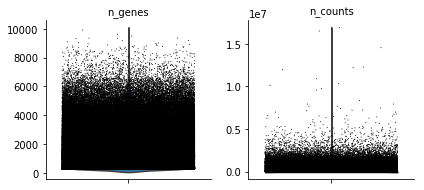

In [9]:
axs = sc.pl.violin(adata, ['n_genes', 'n_counts'],
                   jitter=0.4, multi_panel=True)

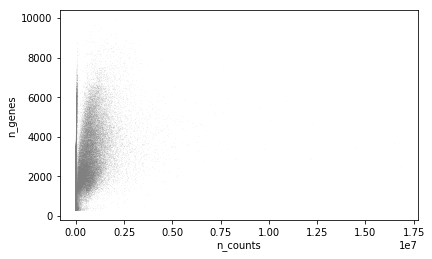

In [10]:
ax = sc.pl.scatter(adata, x='n_counts', y='n_genes')

In [11]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4) #simple lib size normalization?
adata.raw = adata

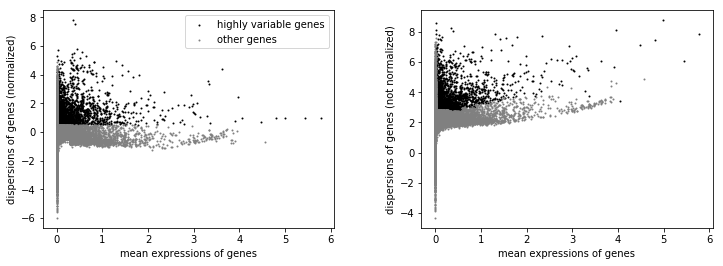

In [12]:
filter_result = sc.pp.filter_genes_dispersion(
    adata.X, min_mean=0.0125, max_mean=10, min_disp=0.5)
sc.pl.filter_genes_dispersion(filter_result)

In [13]:
adata = adata[:, filter_result.gene_subset]
adata.shape

(329232, 2379)

In [14]:
sc.pp.log1p(adata)

In [15]:
sc.pp.scale(adata, max_value=10, zero_center=False)

# Exploration
## PCA

In [16]:
sc.tl.pca(adata)

saving figure to file ./figures/pca_scatter_all_ages_droplet_facs_tissue.pdf


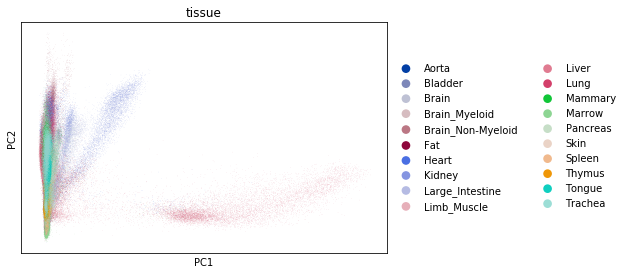

In [17]:
ax = sc.pl.pca_scatter(adata, color=['tissue'], right_margin=0.5, save='_all_ages_droplet_facs_tissue.pdf')

In [18]:
tissue_list = list(set(adata.obs['tissue']))
index = ['3m','18m','21m','24m']

maca_data_collection = pd.DataFrame(columns = tissue_list)
maca_data_collection = maca_data_collection.reindex(index)
for i in range(0,len(tissue_list)):
    aux = adata.obs[adata.obs['tissue'] == tissue_list[i]]
    

    age_list = set(adata.obs[adata.obs['tissue'] == tissue_list[i]]['age'])

    if '3m' in age_list:
        method_list = set(aux[aux['age'] == '3m']['method'])
        if len(method_list) == 2:
            maca_data_collection[tissue_list[i]][0] = 'both'
        else:        
            maca_data_collection[tissue_list[i]][0] = method_list.pop()
    else:        
        maca_data_collection[tissue_list[i]][0] = ''
    if '18m' in age_list:
        method_list = set(aux[aux['age'] == '18m']['method'])
        if len(method_list) == 2:
            maca_data_collection[tissue_list[i]][1] = 'both'
        else:        
            maca_data_collection[tissue_list[i]][1] = method_list.pop()
    else:        
        maca_data_collection[tissue_list[i]][1] = ''
    if '21m' in age_list:
        method_list = set(aux[aux['age'] == '21m']['method'])
        if len(method_list) == 2:
            maca_data_collection[tissue_list[i]][2] = 'both'
        else:        
            maca_data_collection[tissue_list[i]][2] = method_list.pop()
    else:        
        maca_data_collection[tissue_list[i]][2] = ''
    if '24m' in age_list:
        method_list = set(aux[aux['age'] == '24m']['method'])
        if len(method_list) == 2:
            maca_data_collection[tissue_list[i]][3] = 'both'
        else:        
            maca_data_collection[tissue_list[i]][3] = method_list.pop()
    else:        
        maca_data_collection[tissue_list[i]][3] = ''


maca_data_collection.to_csv('./write/maca_data_collection.csv')

saving figure to file ./figures/pca_scatter_all_ages_droplet_facs_age.pdf


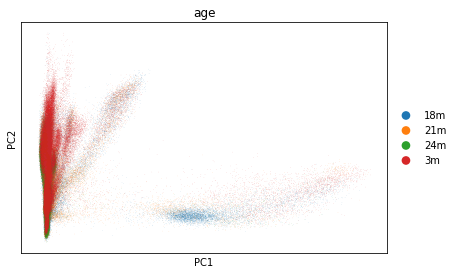

In [19]:
ax = sc.pl.pca_scatter(adata, color=['age'], right_margin=0.5, save='_all_ages_droplet_facs_age.pdf')

saving figure to file ./figures/pca_scatter_all_ages_droplet_facs_sex.pdf


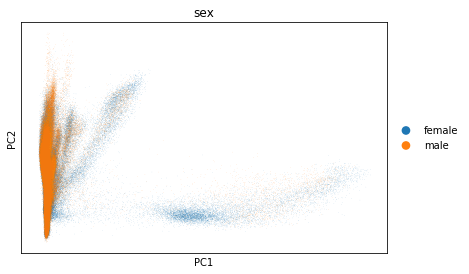

In [20]:
ax = sc.pl.pca_scatter(adata, color=['sex'], right_margin=0.5, save='_all_ages_droplet_facs_sex.pdf')

saving figure to file ./figures/pca_scatter_all_ages_droplet_facs_counts.pdf


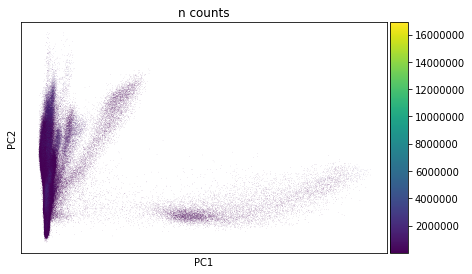

In [21]:
ax = sc.pl.pca_scatter(adata, color='n_counts', right_margin=0.5, save='_all_ages_droplet_facs_counts.pdf')

saving figure to file ./figures/pca_scatter_all_ages_droplet_facs_method.pdf


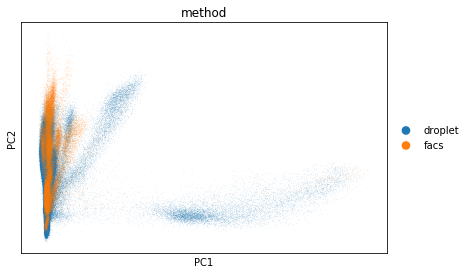

In [22]:
ax = sc.pl.pca_scatter(adata, color='method', right_margin=0.5, save='_all_ages_droplet_facs_method.pdf')

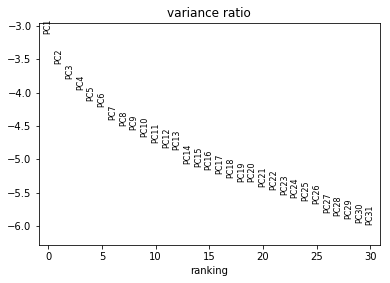

In [23]:
sc.pl.pca_variance_ratio(adata, log=True)

## Louvain clustering

In [24]:
sc.pp.neighbors(adata, n_neighbors=15)#, method='gauss')
sc.tl.louvain(adata, resolution = 0.3)

In [25]:
adata

AnnData object with n_obs × n_vars = 329232 × 2379 
    obs: 'age', 'batch', 'cell', 'cell_ontology_class', 'cell_ontology_id', 'channel', 'free_annotation', 'method', 'n_genes', 'sex', 'subtissue', 'tissue', 'n_counts', 'louvain'
    var: 'n_cells'
    uns: 'pca', 'tissue_colors', 'age_colors', 'sex_colors', 'method_colors', 'neighbors', 'louvain'
    obsm: 'X_pca'
    varm: 'PCs'

## UMAP

In [26]:
sc.tl.umap(adata)

saving figure to file ./figures/umap_all_ages_droplet_facs_tissue.pdf


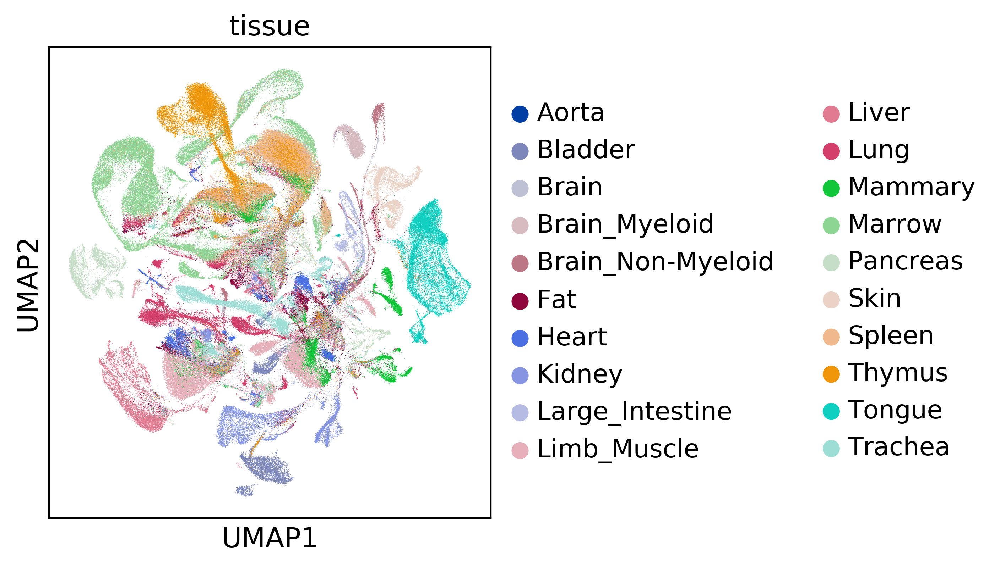

In [27]:
sc.settings.set_figure_params(dpi=200)
sc.pl.umap(adata, color=['tissue'], right_margin=0.5, save='_all_ages_droplet_facs_tissue.pdf')

saving figure to file ./figures/umap_all_ages_droplet_facs_age.pdf


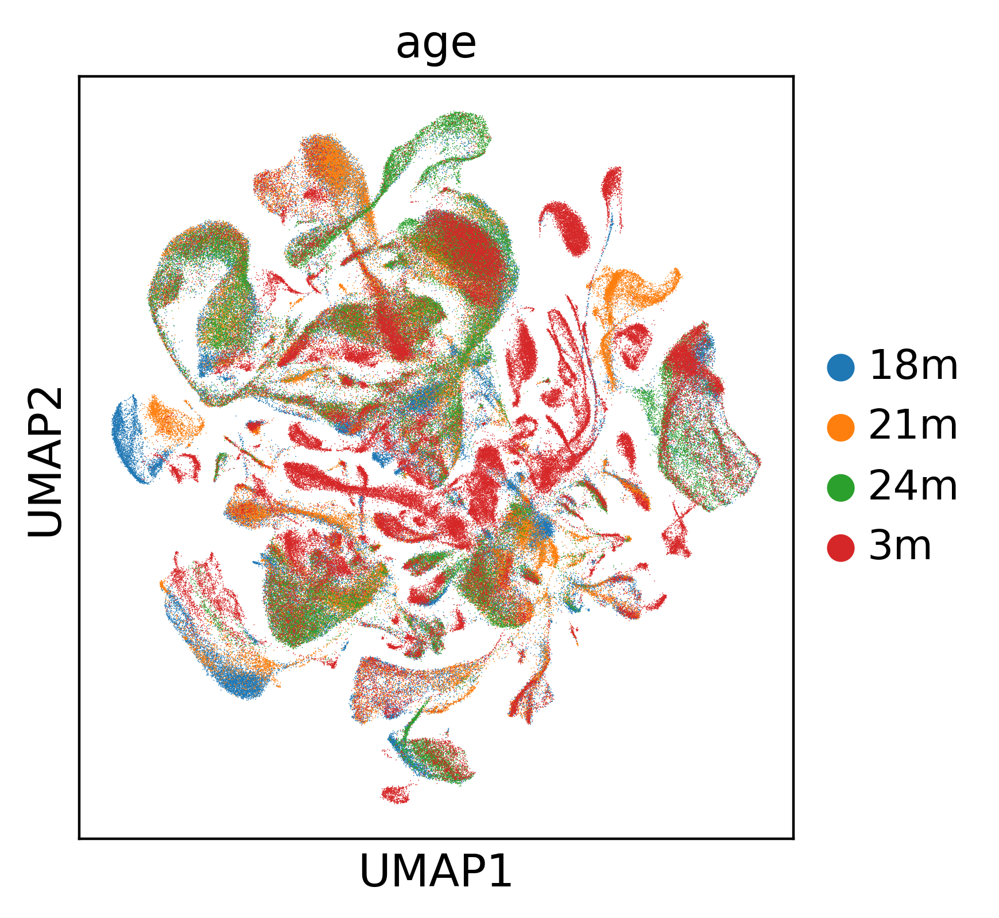

In [28]:
sc.settings.set_figure_params(dpi=200)
sc.pl.umap(adata, color=['age'], right_margin=0.5, save='_all_ages_droplet_facs_age.pdf')

saving figure to file ./figures/umap_all_ages_droplet_facs_sex.pdf


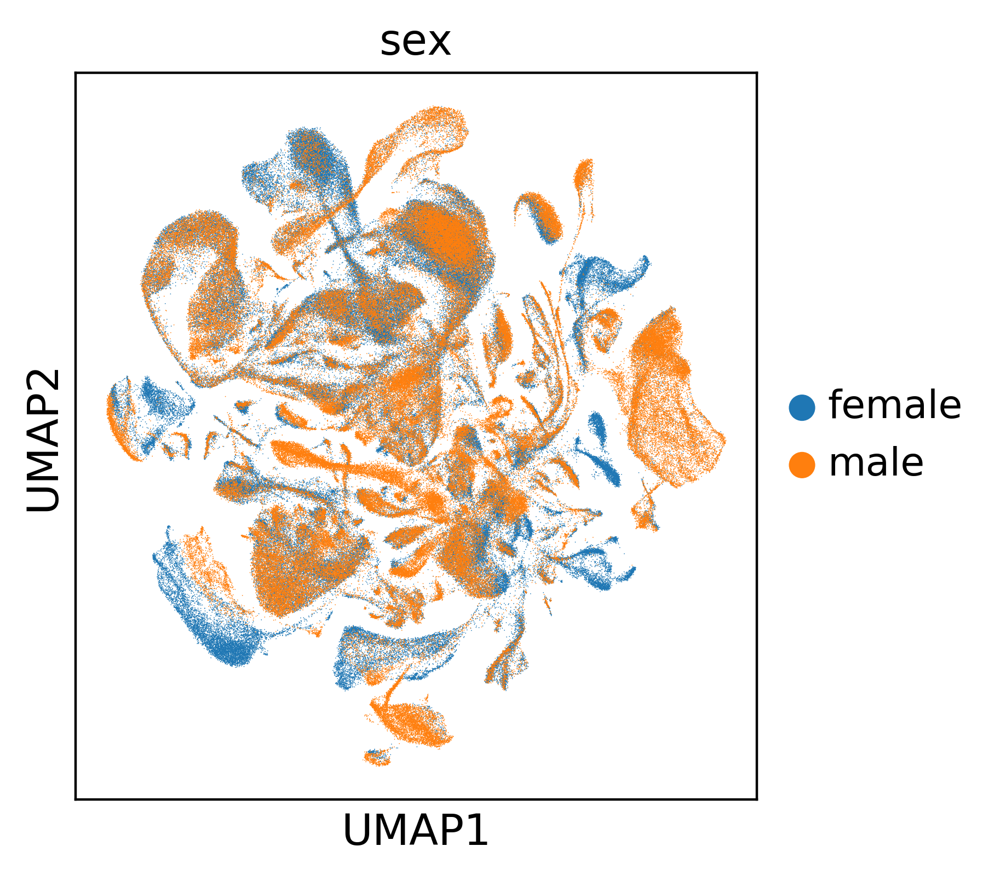

In [29]:
sc.settings.set_figure_params(dpi=200)
sc.pl.umap(adata, color=['sex'], right_margin=0.5, save='_all_ages_droplet_facs_sex.pdf')

saving figure to file ./figures/umap_all_ages_droplet_facs_louvain.pdf


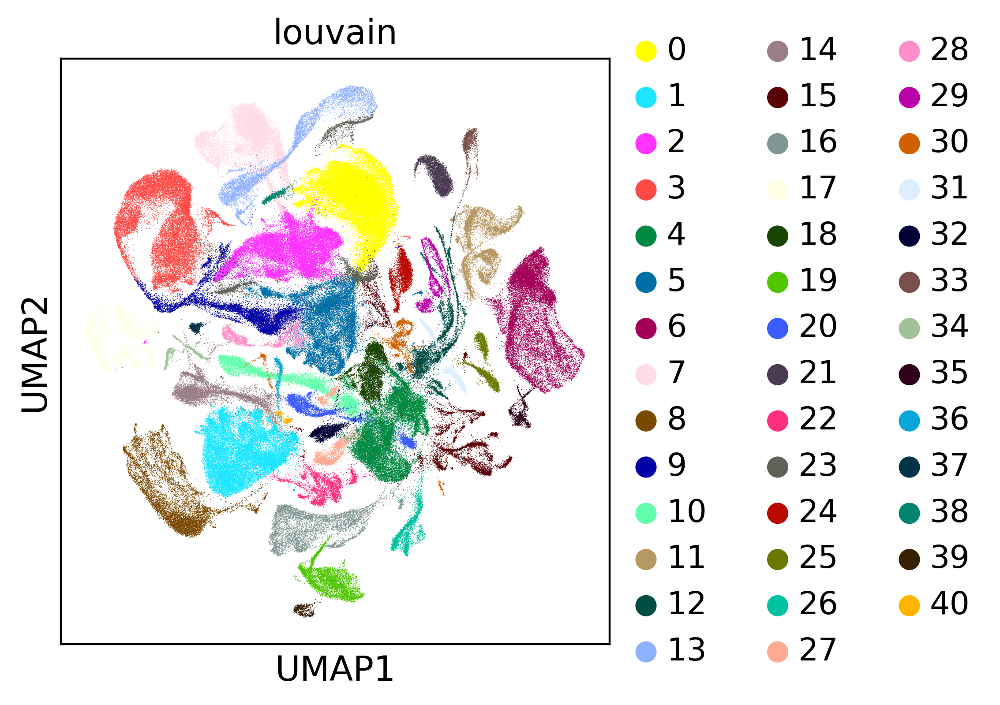

In [30]:
sc.settings.set_figure_params(dpi=200)
sc.pl.umap(adata, color=['louvain'], right_margin=0.5, save='_all_ages_droplet_facs_louvain.pdf')

saving figure to file ./figures/umap_all_ages_droplet_facs_method.pdf


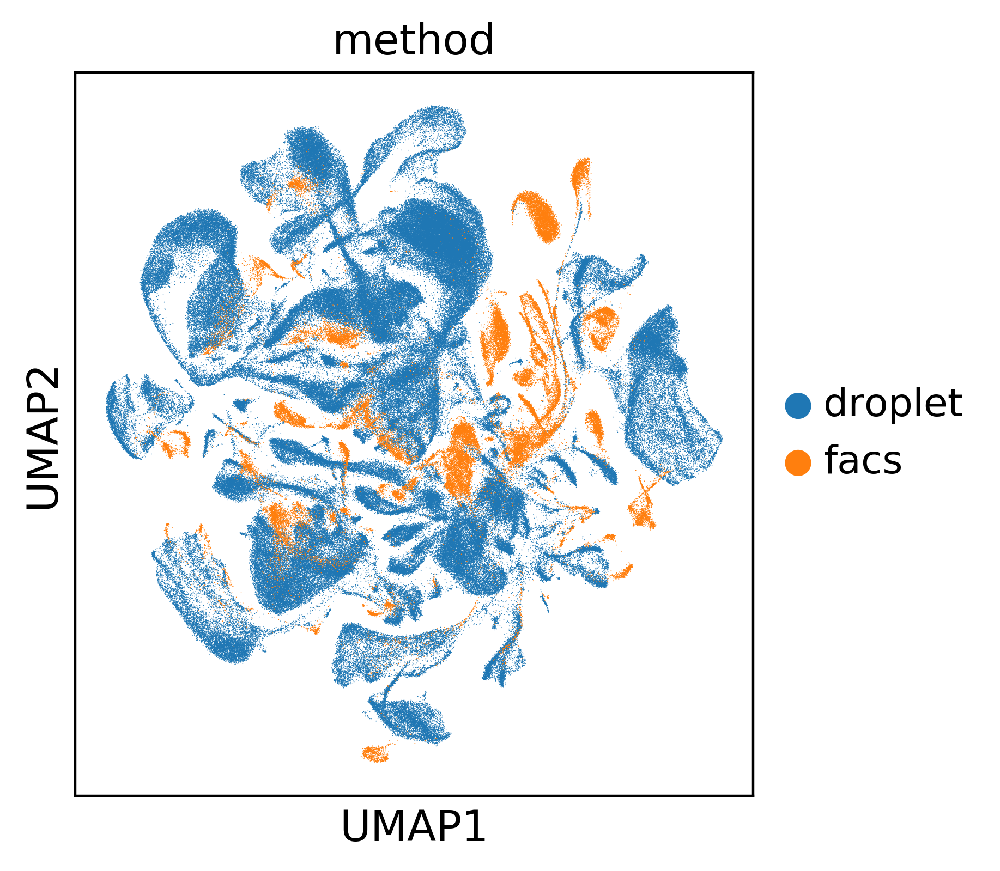

In [31]:
sc.settings.set_figure_params(dpi=200)
sc.pl.umap(adata, color=['method'], right_margin=0.5, save='_all_ages_droplet_facs_method.pdf')

## tSNE

In [32]:
sc.tl.tsne(adata, perplexity=50)

saving figure to file ./figures/tsne_all_ages_droplet_facs_tissue.pdf


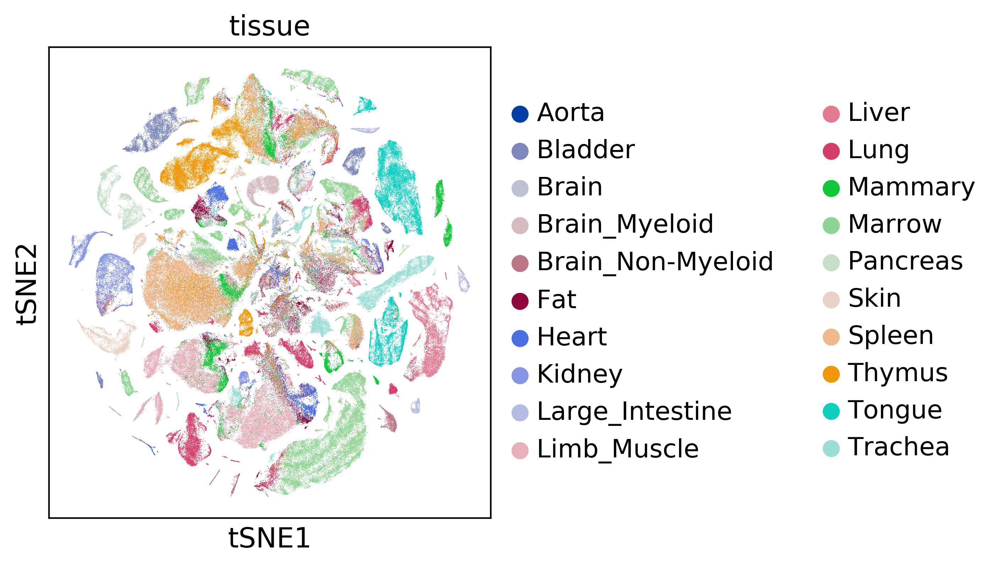

In [33]:
sc.settings.set_figure_params(dpi=200)
sc.pl.tsne(adata, color=['tissue'], right_margin=0.5, save='_all_ages_droplet_facs_tissue.pdf')

saving figure to file ./figures/tsne_all_ages_droplet_facs_age.pdf


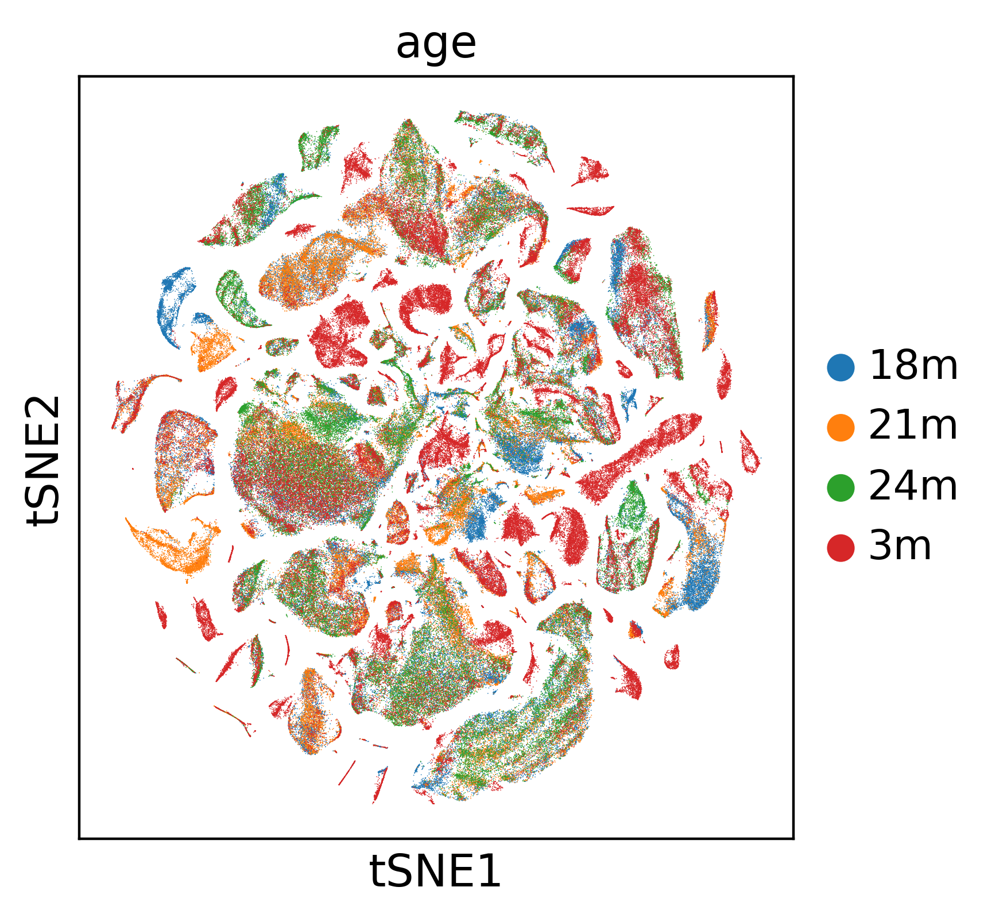

In [34]:
sc.pl.tsne(adata, color=['age'], right_margin=0.5, save='_all_ages_droplet_facs_age.pdf')

saving figure to file ./figures/tsne_all_ages_droplet_facs_sex.pdf


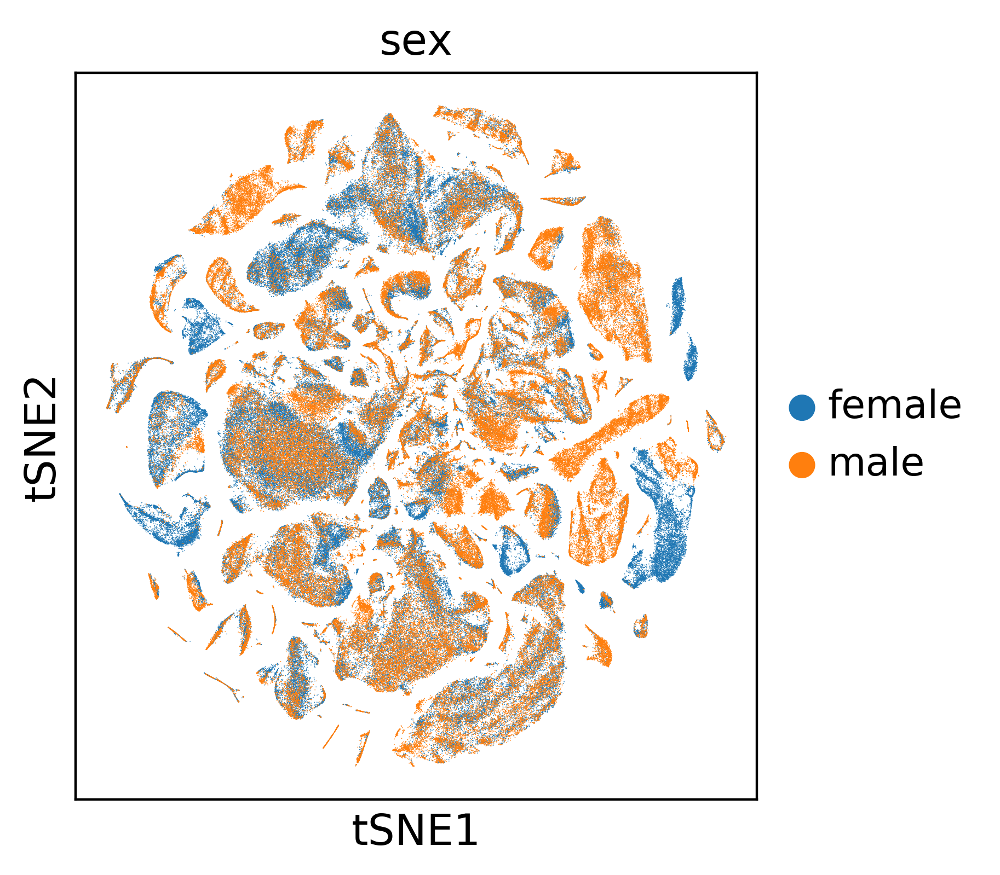

In [35]:
sc.pl.tsne(adata, color=['sex'], right_margin=0.5, save='_all_ages_droplet_facs_sex.pdf')

saving figure to file ./figures/tsne_all_ages_droplet_facs_method.pdf


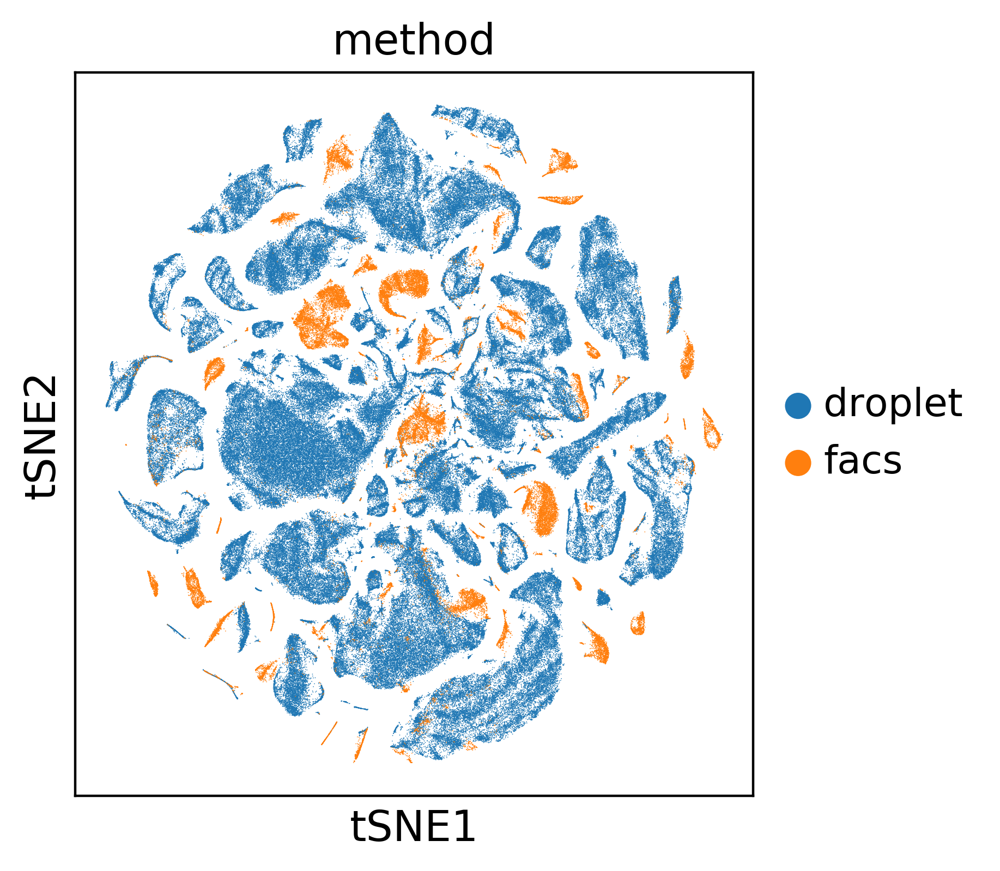

In [36]:
sc.pl.tsne(adata, color=['method'], right_margin=0.5, save='_all_ages_droplet_facs_method.pdf')

saving figure to file ./figures/tsne_all_ages_droplet_facs_louvain.pdf


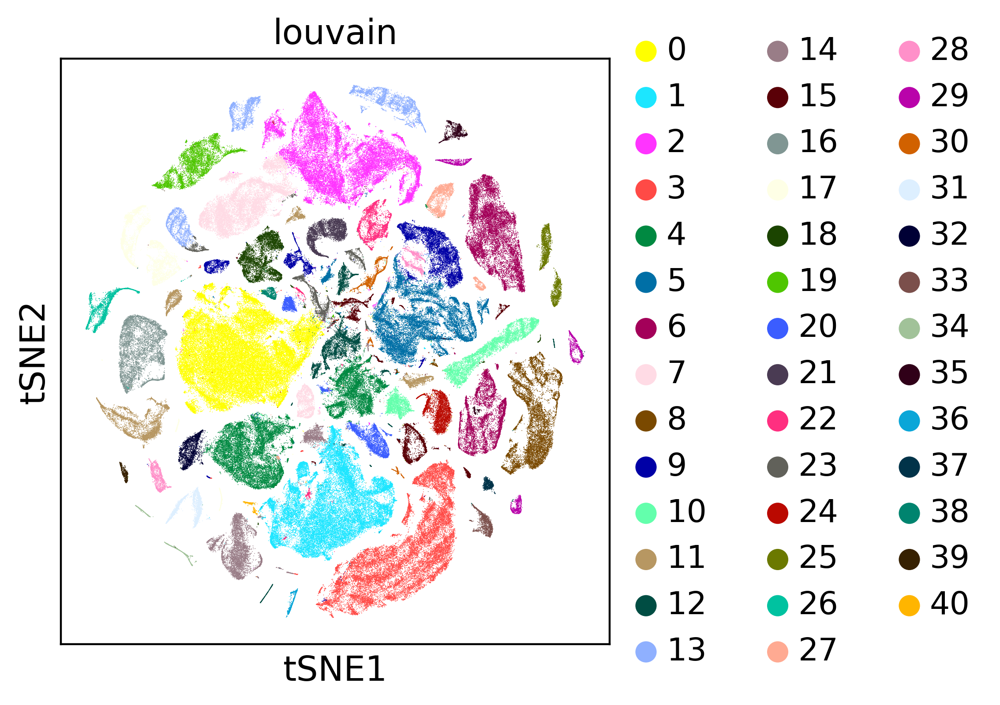

In [37]:
sc.pl.tsne(adata, color=['louvain'], right_margin=0.5, save='_all_ages_droplet_facs_louvain.pdf')

# Save processed data

In [38]:
adata.write('./write/maca-droplet-facs.processed.h5ad')

In [ ]:
adata = read_h5ad('./write/maca-droplet-facs.processed.h5ad')